In [1]:
from PIL import Image, ImageDraw, ImageFont
import face_recognition
import numpy as np
import os
import cv2
from IPython.display import display

In [5]:
database_path = '../images/database/'
test_path = '../images/test_imgs/'
database_imgs = [image for image in os.listdir(database_path)]
test_imgs = [image for image in os.listdir(test_path)]

# store face encodings and labels
known_face_encodings = np.zeros((len(database_imgs),128))
for i, image in enumerate(database_imgs):
    img = face_recognition.load_image_file(os.path.join(database_path, image))
    face_encoding = face_recognition.face_encodings(img)[0]
    known_face_encodings[i] = face_encoding
    
known_face_names = [image.split('.')[0] for image in os.listdir(database_path)]

print('Learned encoding for', len(known_face_encodings), 'images.')

Learned encoding for 3 images.


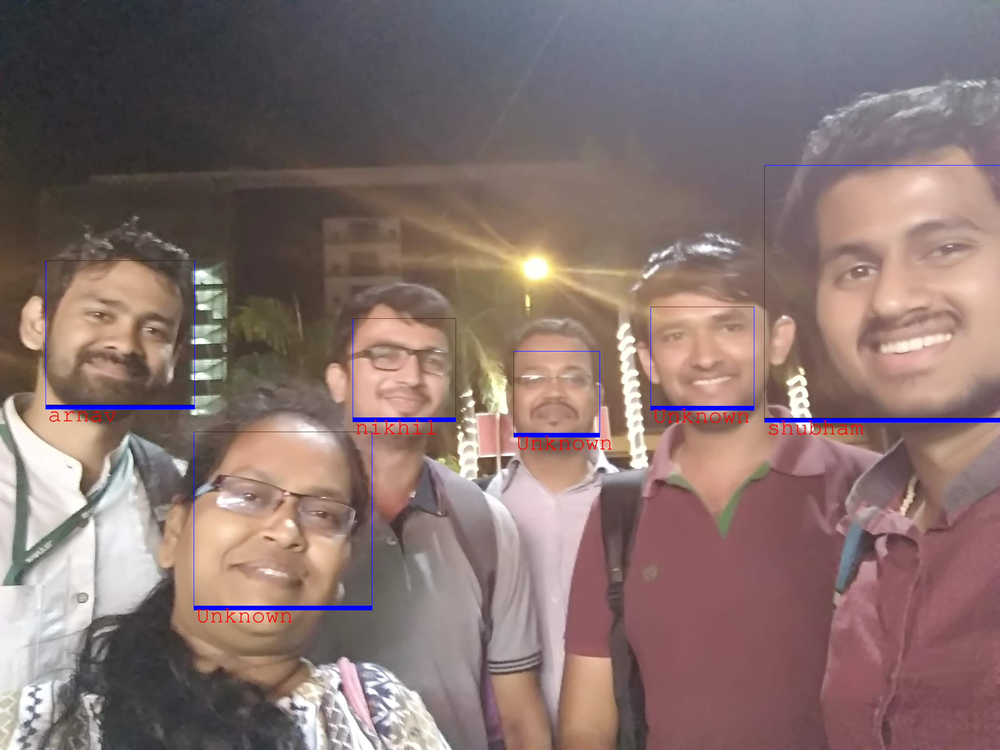

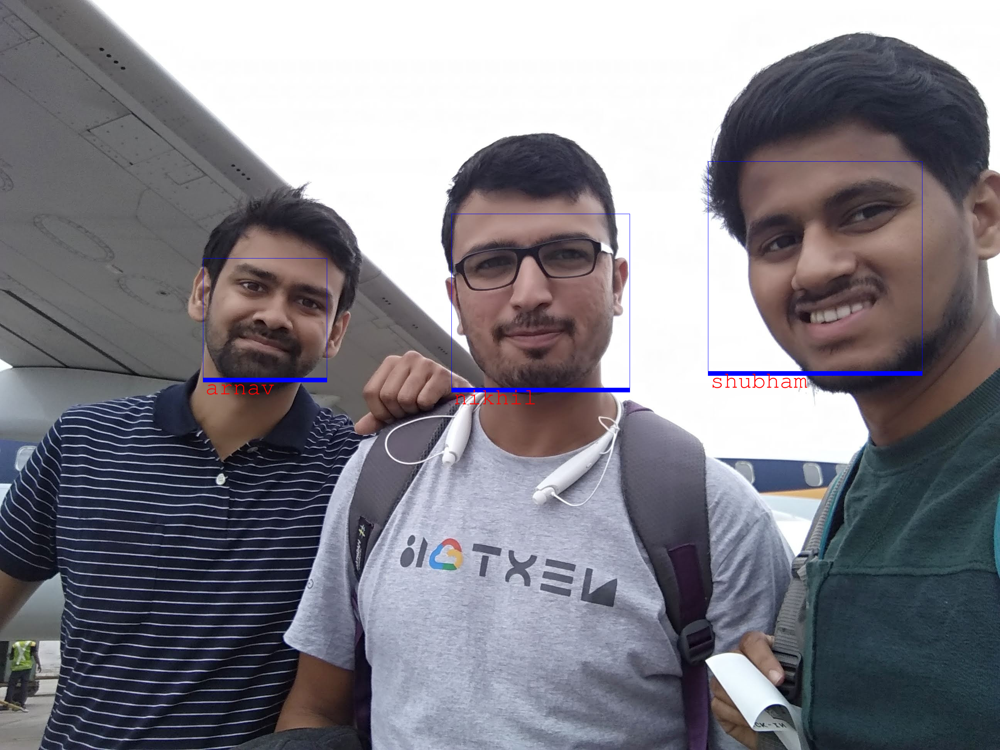

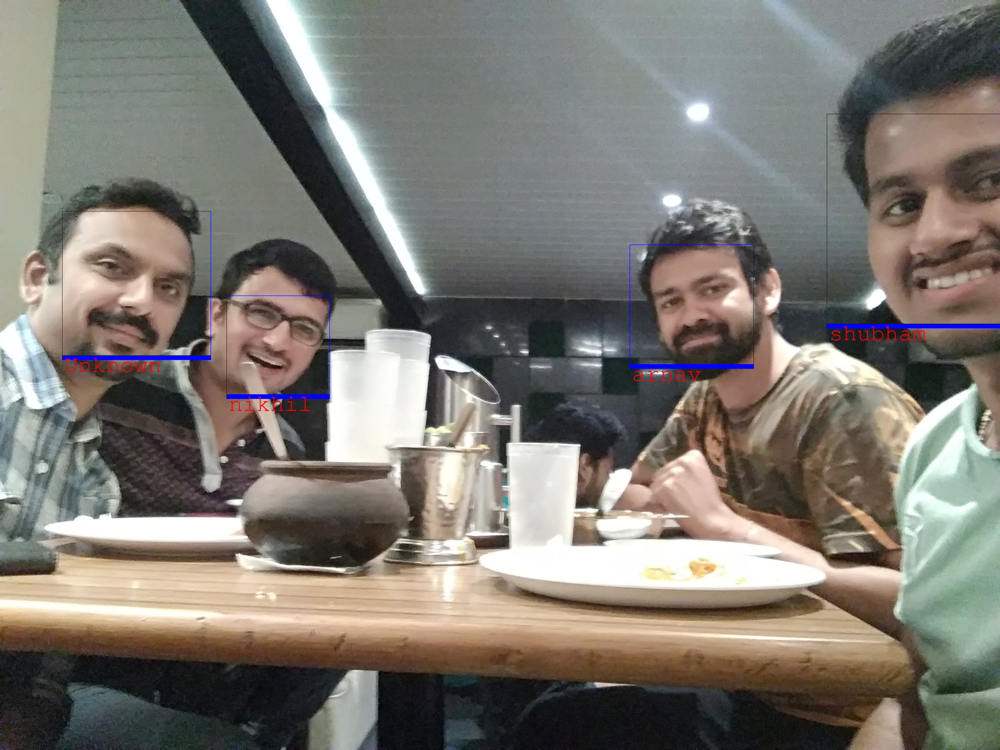

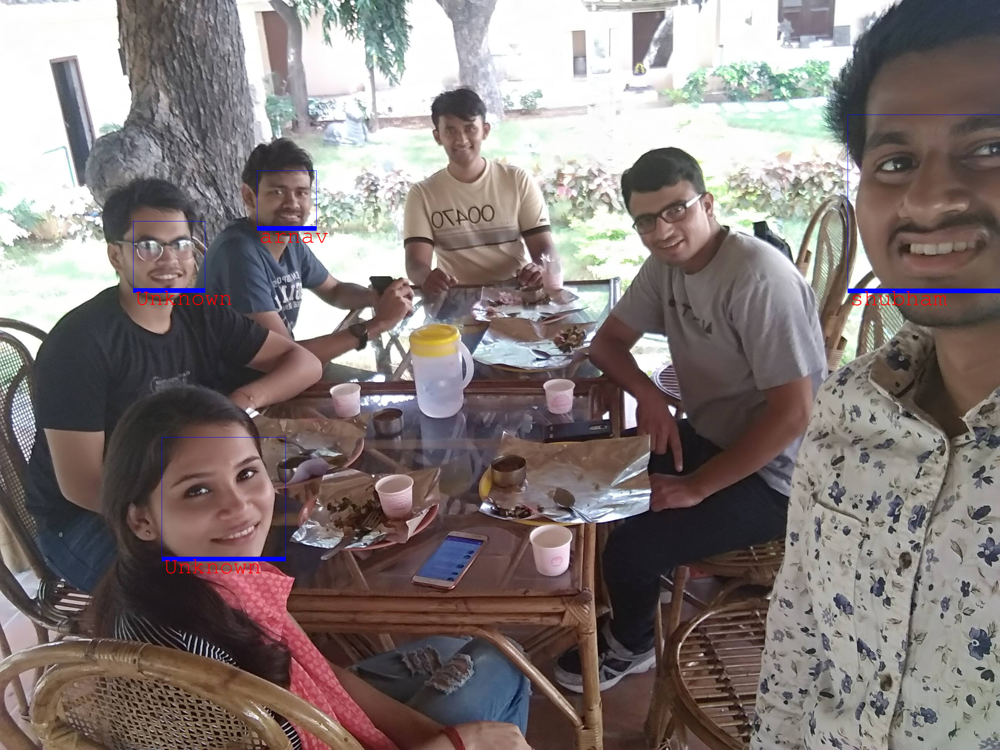

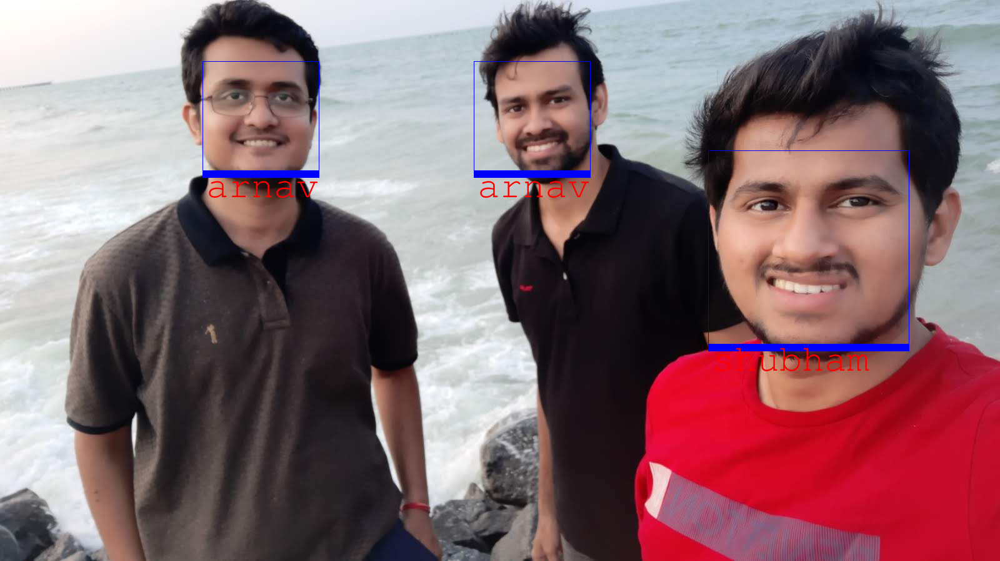

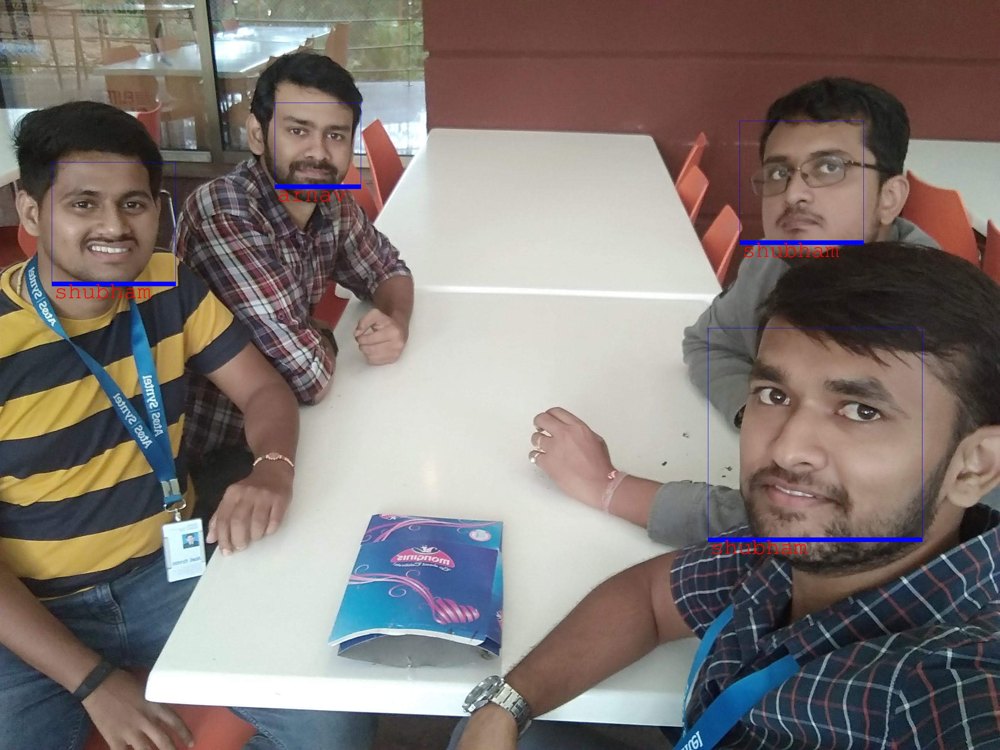

In [6]:
test_imgs = [image for image in os.listdir(test_path)]

# run on test images
for image in test_imgs:
    
    sample_image = face_recognition.load_image_file(os.path.join(test_path, image))

    face_locations = face_recognition.face_locations(sample_image)
    image_encoding = face_recognition.face_encodings(sample_image, face_locations)

    pil_img = Image.fromarray(sample_image)
    draw = ImageDraw.Draw(pil_img)
    
    # check for closest matches
    for (top, right, bottom, left), face_encoding in zip(face_locations, image_encoding):
        matches = face_recognition.compare_faces(known_face_encodings, face_encoding)
        name = "Unknown"

        face_distances = face_recognition.face_distance(known_face_encodings, face_encoding)
        best_match_index = np.argmin(face_distances)
        if matches[best_match_index]:
            name = known_face_names[best_match_index]
#         else:
#             print('Face not in the database')

        draw.rectangle(((left, top), (right, bottom)), outline=(0, 0,255))
        text_width, text_height = draw.textsize(name)
        draw.rectangle(((left, bottom - text_height), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
        fnt = ImageFont.truetype('../fonts/FreeMono.ttf', 60)
        draw.text((left + 6, bottom - text_height - 5), name, font=fnt, fill=(255, 0, 0, 0))
    #     display(pil_img)
    del draw

    display(pil_img)